In [1]:
import scanpy as sc
import pandas as pd
import umap
import seaborn as sns
import numpy as np
from sklearn import preprocessing
import matplotlib.pyplot as plt
from pathlib import Path
from matplotlib import colors
import matplotlib as mpl
import matplotlib.cm as cm

In [2]:
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=400, frameon=True, vector_friendly=True, fontsize=10, figsize=(8, 8),
                     color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')

In [3]:
mpl.rcParams["pdf.fonttype"] = 42
mpl.rcParams["ps.fonttype"] = 42

## Plots for CD45 data

In [4]:
sc.settings.figdir = "scRNA-seq/Redone22/Manuscript/CD45"

In [5]:
adata = sc.read("scRNA-seq/Redone22/CD45_Reclustered/Data/CD45_Reclustered_processed_05012023.h5ad")

In [10]:
adata.raw.to_adata().X.todense()

matrix([[0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ],
        [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ],
        [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ],
        ...,
        [0.       , 0.       , 1.4135252, ..., 0.       , 0.       ,
         0.       ],
        [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ],
        [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ]], dtype=float32)

In [6]:
marker_genes_dict = {
        "0": ["IL7R", "ZFP36L2", "VIM"],
        "6": ["IL32", "BAG3", "IFNG"],
        "11": ["FOXP3", "IL2RA", "CTLA4"],
        "3": ["GZMK", "GZMM", "CXCR4"],
        "4": ["LAG3", "CTLA4", "PDCD1"],
        "5": ["CCL5", "PTPRC", "GZMH"],
        "9": ["GZMH", "FGFBP2", "PRF1"],
        "13": ["DUSP4", "CD27", "IGKC"],
        "8": ["TRAV1-2", "KLRB1", "SLC4A10"],
        "14": ["MKI67", "PCNA", "STMN1"],
        "16": ["KIT", "GATA3", "IL2RA"],
        "1": ["GNLY", "NKG7", "FCGR3A"],
        "2": ["NCAM1", "KLRB1", "FCER1G"],
        "7": ["HLA-DRA", "TREM1", "LYZ", "CD163"],
        "10": ["CD68", "CD14", "ITGAX"],
        "15": ["CLEC9A", "IDO1", "C1orf54"],
        "17": ["IL3RA", "IRF7", "PLD4"],
        "12": ["CD79A", "CD19", "CD74"],
    }

#sc.pl.matrixplot(adata, marker_genes_dict, "leiden_r1.0",
#                 colorbar_title='mean z-score', cmap='viridis', use_raw=True, swap_axes=True,)

In [7]:
dge_path = Path("scRNA-seq/Redone22/CD45_Reclustered/DGE/leiden_r1.0.xlsx")
df_dict = pd.read_excel(dge_path, sheet_name=None)

In [8]:
"""
lfc_df_lst = []
conv_t_cell = ["CD3E", "CD3G", "CD8A", "CD4"]
for i in range(18):
    lfc_gene_selection = marker_genes_dict[f"{i}"] + conv_t_cell
    df_partial = df_dict[f"c{i}"][df_dict[f"c{i}"].names.isin(lfc_gene_selection)][["group", "names", "logfoldchanges"]]
    lfc_df_lst.append(df_partial)
"""

'\nlfc_df_lst = []\nconv_t_cell = ["CD3E", "CD3G", "CD8A", "CD4"]\nfor i in range(18):\n    lfc_gene_selection = marker_genes_dict[f"{i}"] + conv_t_cell\n    df_partial = df_dict[f"c{i}"][df_dict[f"c{i}"].names.isin(lfc_gene_selection)][["group", "names", "logfoldchanges"]]\n    lfc_df_lst.append(df_partial)\n'

In [9]:
#df_lfc = pd.concat(lfc_df_lst)
#df_lfc.reset_index(inplace=True, drop=True)

In [10]:
#foo = df_lfc.pivot("names", "group").fillna(0)

In [11]:
"""
divnorm = colors.TwoSlopeNorm(vmin=foo.min().min(), vcenter=0, vmax=foo.max().max())

cg = sns.clustermap(foo, xticklabels=1, yticklabels=1, metric="correlation", cmap="RdBu_r", norm=divnorm, linewidths=0.2, linecolor="lightgray")
cg.ax_row_dendrogram.set_visible(False)
cg.ax_col_dendrogram.set_visible(False)
plt.suptitle("Logfoldchanges of CD45 clusters")
#plt.savefig("scRNA-seq/Redone22/CD45_Reclustered/Manuscript/LFC_Heatmap.pdf", dpi=300)
#plt.show()
"""

'\ndivnorm = colors.TwoSlopeNorm(vmin=foo.min().min(), vcenter=0, vmax=foo.max().max())\n\ncg = sns.clustermap(foo, xticklabels=1, yticklabels=1, metric="correlation", cmap="RdBu_r", norm=divnorm, linewidths=0.2, linecolor="lightgray")\ncg.ax_row_dendrogram.set_visible(False)\ncg.ax_col_dendrogram.set_visible(False)\nplt.suptitle("Logfoldchanges of CD45 clusters")\n#plt.savefig("scRNA-seq/Redone22/CD45_Reclustered/Manuscript/LFC_Heatmap.pdf", dpi=300)\n#plt.show()\n'

In [12]:
df = pd.read_excel("scRNA-seq/Redone22/CD45_Reclustered/CD45_Annotation.xlsx", sheet_name="Cluster_Annotation")

In [13]:
cluster_map = dict(df[["Cluster_Number", "Cluster_Name"]].values)
color_map = dict(df[["Cluster_Name", "Color_Code"]].values)

adata.obs["leiden_r1.0"] = adata.obs["leiden_r1.0"].astype(int)
adata.obs["leiden_r1.0"] = adata.obs["leiden_r1.0"].map(cluster_map)

In [14]:
tissue_name_map = {"Control": "Adjacent Liver",
                  "Rim": "Rim",
                  "Core": "Tumor core"}

tissue_map = {"Adjacent Liver" : "#E86991",
              "Rim" : "#BEB85F",
              "Tumor core" : "#1AB46A"}

adata.obs["Tissue"] = adata.obs["Tissue"].map(tissue_name_map)

In [15]:
patient_name_map = {patName:patName for patName in adata.obs.Patient.unique()}
patient_name_map["Pat52"] = "LHCC40"

patient_map = {"LHCC35" : "#BC00FF",
               "LHCC40" : "#265aa0",
               "LHCC44" : "#8a6500",
               "LHCC45" : "#8317bd",
               "LHCC46" : "#565656",
               "LHCC47" : "#008652",
               "LHCC48" : "#00ff00",
               "LHCC54" : "#ea9aff"
}
adata.obs["Patient"] = adata.obs["Patient"].map(patient_name_map)

In [16]:
sc.tl.umap(adata, a=5, b=2.5, random_state=0)

In [17]:
adata.obs.groupby(["Patient", f"leiden_r1.0"]).count()["Sample"].to_csv(f"scRNA-seq/Redone22/Manuscript/CD45/leiden_r1.0_cluster_counts_perPatient.csv")

In [18]:
adata.obs.groupby(["Tissue", f"leiden_r1.0"]).count()["Sample"].to_csv(f"scRNA-seq/Redone22/Manuscript/CD45/leiden_r1.0_cluster_counts_perTissue.csv")

In [67]:
adata.obs.groupby([f"leiden_r1.0", "Tissue", "Patient"]).count()["Sample"].to_csv(f"scRNA-seq/Redone22/Manuscript/CD45/leiden_r1.0_cluster_counts_perTissuePatient.csv")

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


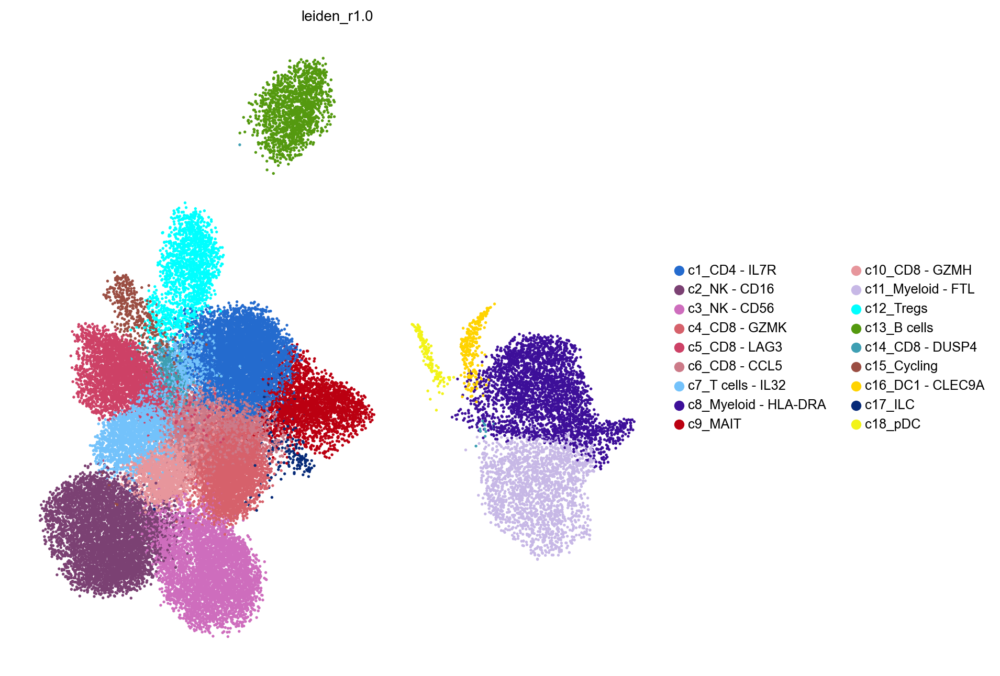

In [19]:
sc.pl.umap(adata, color="leiden_r1.0", palette=color_map, s=15, legend_loc="right margin", save="_CD45-Cluster.pdf", frameon=False)

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


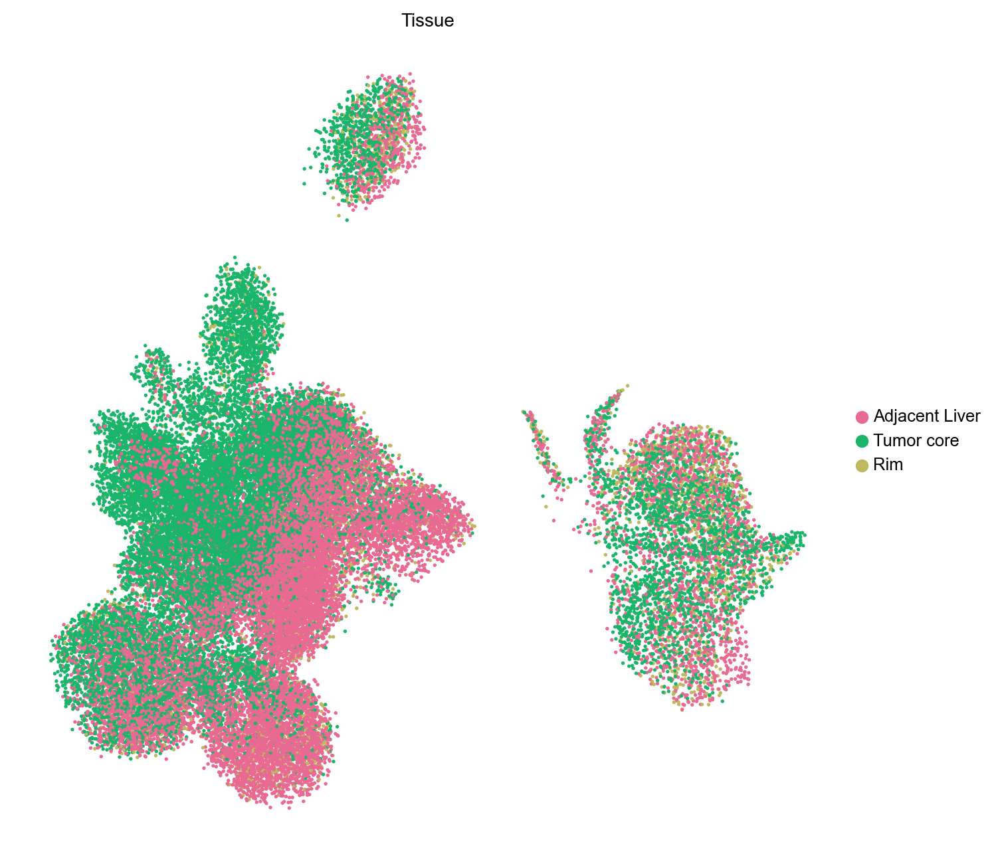

In [20]:
sc.pl.umap(adata, color="Tissue", palette=tissue_map, s=15, legend_loc="right margin", save="_CD45-Tissue.pdf", frameon=False)

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


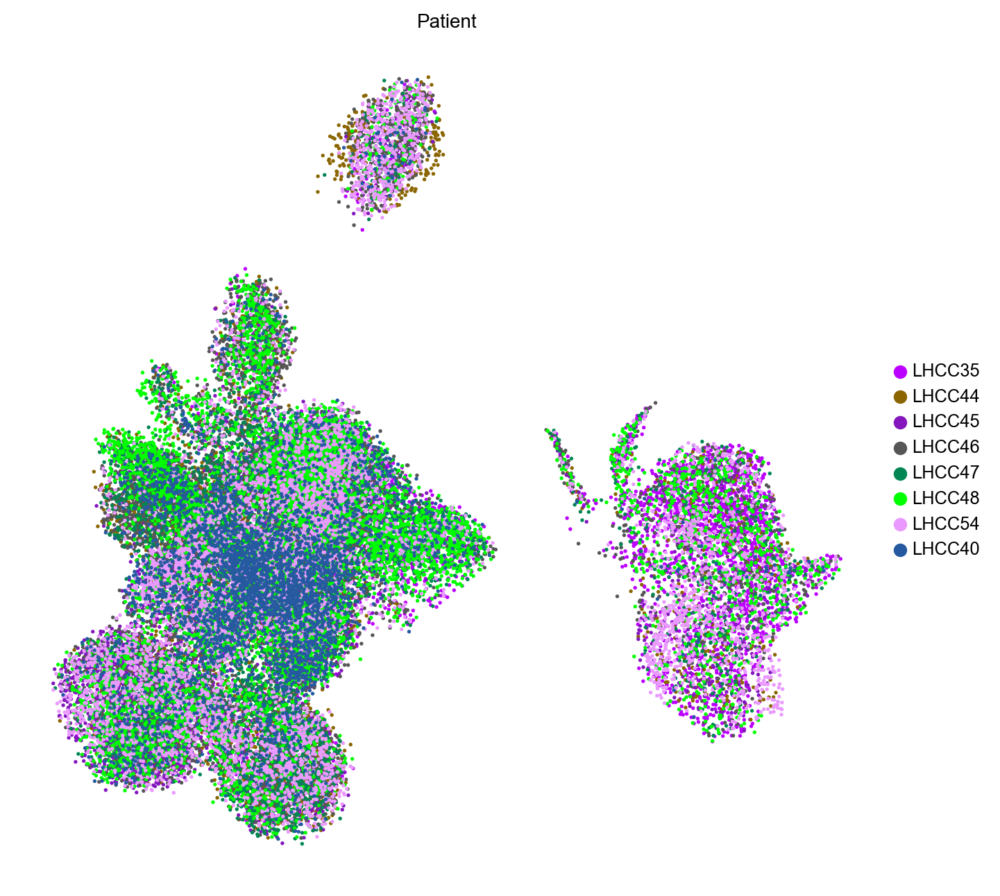

In [21]:
sc.pl.umap(adata, color="Patient", palette=patient_map, s=15, legend_loc="right margin", save="_CD45-Patient.pdf", frameon=False)

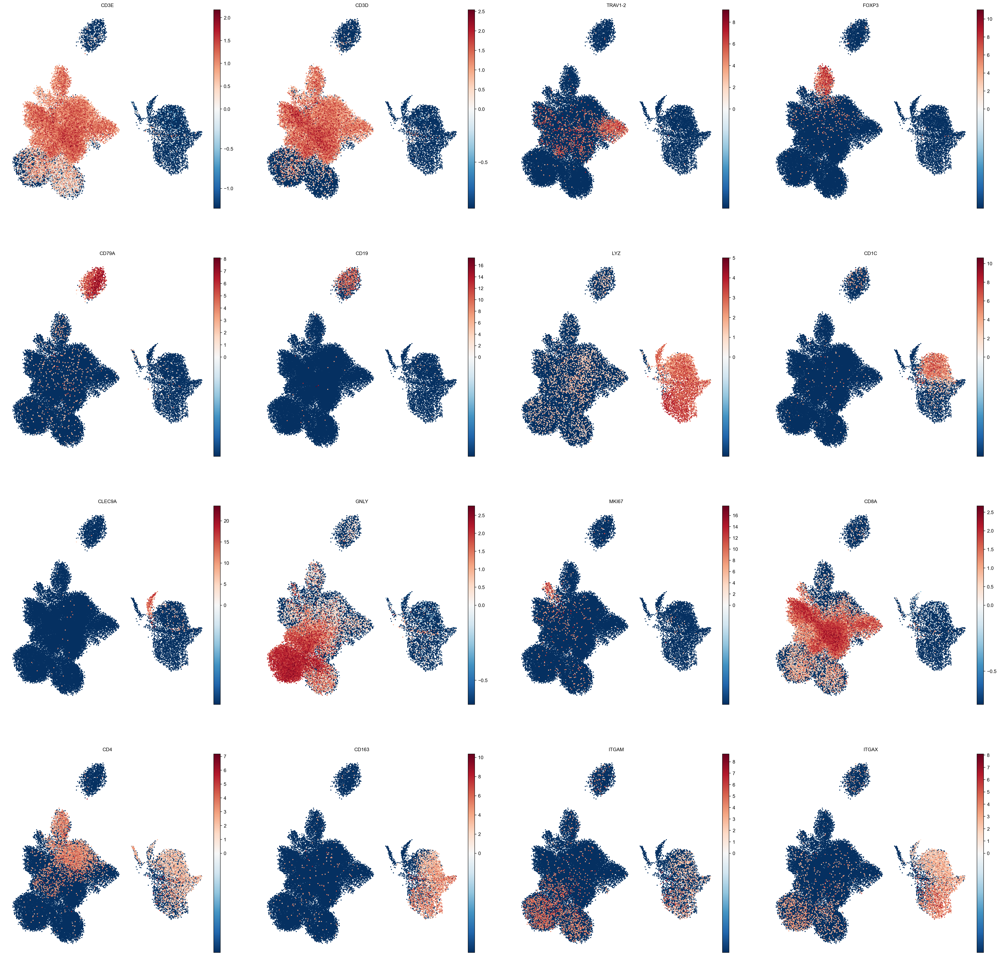

In [22]:
umap_genes_lst = ["CD3E", "CD3D", "TRAV1-2", "FOXP3", "CD79A", "CD19", "LYZ", "CD1C", "CLEC9A", "GNLY", "MKI67", "CD8A", "CD4", "CD163", "ITGAM", "ITGAX"]

sc.pl.umap(adata, color=umap_genes_lst, s=20, use_raw=False, cmap="RdBu_r", vcenter=0, frameon=False, save="_CD45-Marker.pdf")

In [23]:
heatmap_genes = ["CD3E", "CD3G", "CD8A", "CD4", "IL7R", "ZFP36L2", "VIM", "IL32", "BAG3", "IFNG", "FOXP3", "IL2RA", "CTLA4", 
                 "GZMK", "GZMM", "CXCR4", "LAG3", "CTLA4", "PDCD1", "CCL5", "PTPRC", "GZMH", "GZMH", "FGFBP2", "PRF1", "DUSP4", 
                 "CD27", "IGKC", "TRAV1-2", "KLRB1", "SLC4A10", "MKI67", "PCNA", "STMN1", "KIT", "GATA3", "IL2RA", "GNLY", "NKG7", 
                 "FCGR3A", "NCAM1", "KLRB1", "FCER1G", "HLA-DRA", "TREM1", "LYZ", "CD163", "FLT", "CD68", "CD14", "ITGAX", "CLEC9A", 
                 "IDO1", "C1orf54", "IL3RA", "IRF7", "PLD4 ", "CD79A", "CD19", "CD74"]

heatmap_genes = list(set(heatmap_genes).intersection(adata.var_names))

In [24]:
res = pd.DataFrame(columns=adata.var_names, index=adata.obs["leiden_r1.0"].cat.categories)                                                                                                 

for clust in adata.obs["leiden_r1.0"].cat.categories: 
    res.loc[clust] = adata[adata.obs["leiden_r1.0"].isin([clust]),:].X.mean(0)

In [25]:
res = res[heatmap_genes]

In [26]:
for col in res.columns:
    res[col] = res[col].astype(np.float32)
    # z-score
    res[col] = (res[col]-res[col].mean())/res[col].std()
    #res[col] = res[col]/np.abs(res[col]).max()
res = res.T

In [27]:
divnorm = colors.TwoSlopeNorm(vmin=res.min().min(), vcenter=0, vmax=res.max().max())
cmap = cm.RdBu_r

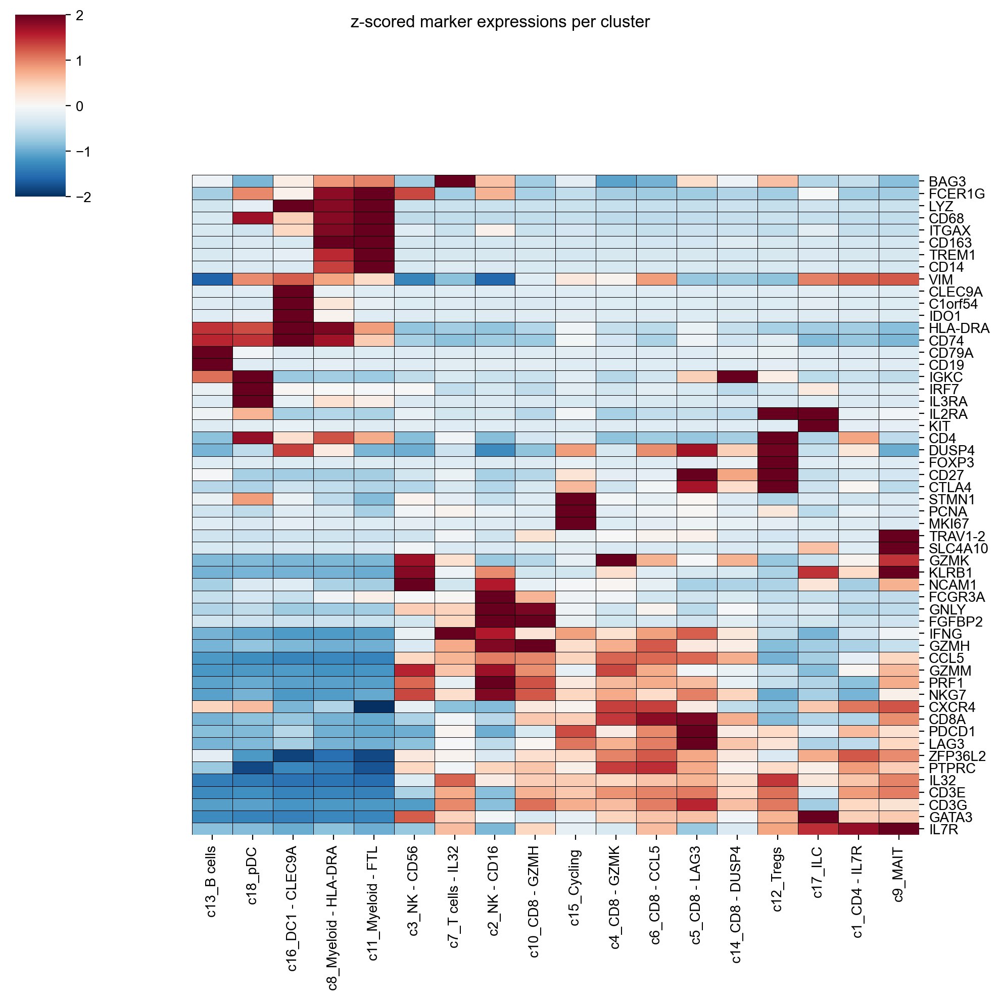

In [28]:
g = sns.clustermap(data=res, cmap=cmap, vmin=-2, vmax=2, metric="correlation", yticklabels=1, linewidths=0.2, linecolor="black",tree_kws={"linewidths": 0.})
plt.suptitle("z-scored marker expressions per cluster")
plt.savefig("scRNA-seq/Redone22/Manuscript/CD45/CD45-Marker_Expression_Heatmap.pdf", dpi=400, transparent=True)
plt.show()

In [29]:
cd45_violin_genes =  ["LYZ", "CD163", "CSF1R"]

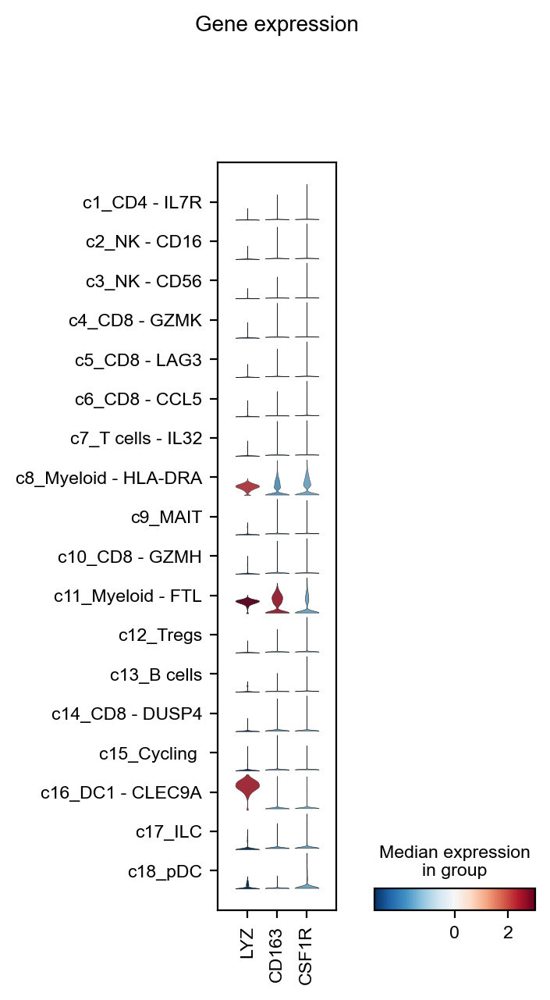

In [30]:
sc.pl.stacked_violin(adata, cd45_violin_genes, groupby=f"leiden_r1.0", dendrogram=False, use_raw=False, 
                     swap_axes=False, vcenter=0, cmap="RdBu_r", title="Gene expression",
                     save=f"leiden_r1.0_violin_plot.pdf")

## Plots for MAIT data

In [4]:
sc.settings.figdir = "scRNA-seq/Redone22/Manuscript/MAIT"

In [5]:
adata = sc.read("scRNA-seq/Redone22/MAIT_Bootstrap/3/Data/MAIT_BOOTSTRAPPED_3.h5ad")

In [6]:
tissue_name_map = {"Control": "Adjacent Liver",
                  "Rim": "Rim",
                  "Core": "Tumor core"}

tissue_map = {"Adjacent Liver" : "#E86991",
              "Rim" : "#BEB85F",
              "Tumor core" : "#1AB46A"}

adata.obs["Tissue"] = adata.obs["Tissue"].map(tissue_name_map)
adata.obs["Patient"] = adata.obs["Patient"].map(patient_name_map)

NameError: name 'patient_name_map' is not defined

In [7]:
sc.tl.umap(adata, a=0.01, b=1.5, random_state=0)

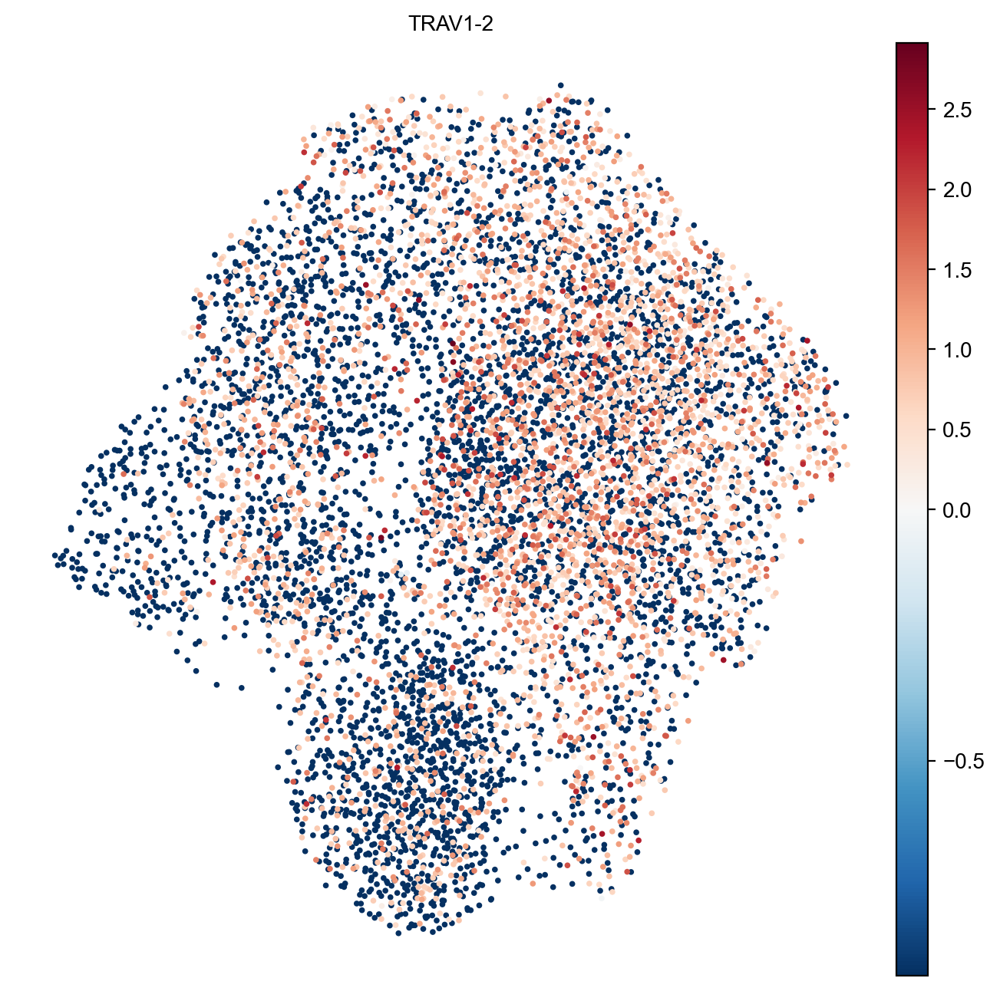

In [12]:
sc.pl.umap(adata, color="TRAV1-2", s=30, use_raw=False, cmap="RdBu_r", vcenter=0,legend_loc="right margin", frameon=False, save="_MAIT-TRAV1-2.pdf")

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


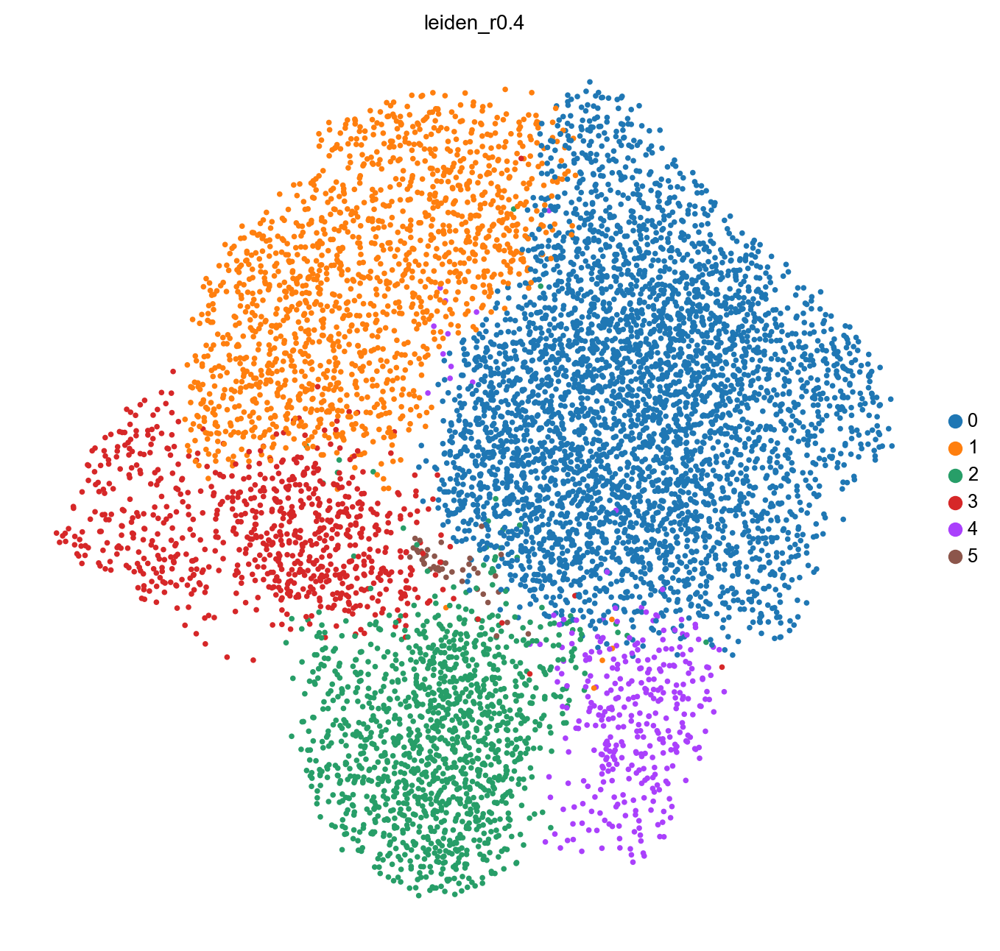

In [37]:
sc.pl.umap(adata, color="leiden_r0.4", s=30, legend_loc="right margin", frameon=False, save="_MAIT-Cluster.pdf")

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


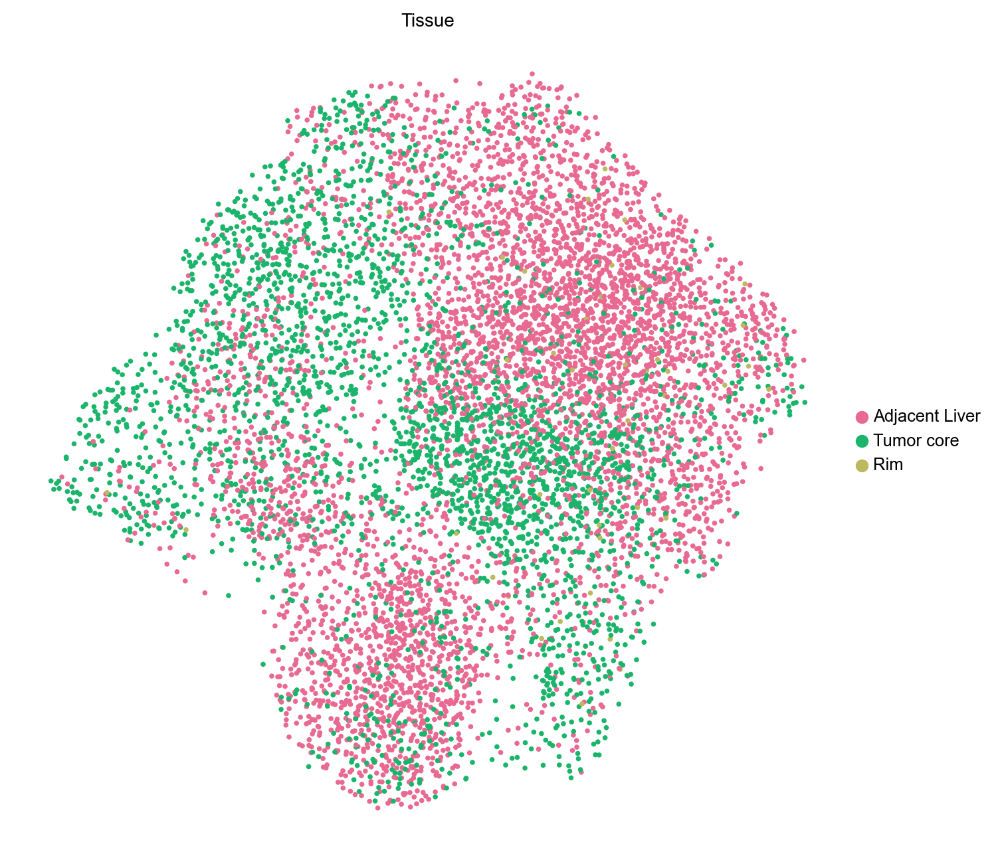

In [38]:
sc.pl.umap(adata, color="Tissue", palette=tissue_map,s=30, legend_loc="right margin", frameon=False, save="_MAIT-Tissue.pdf")

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


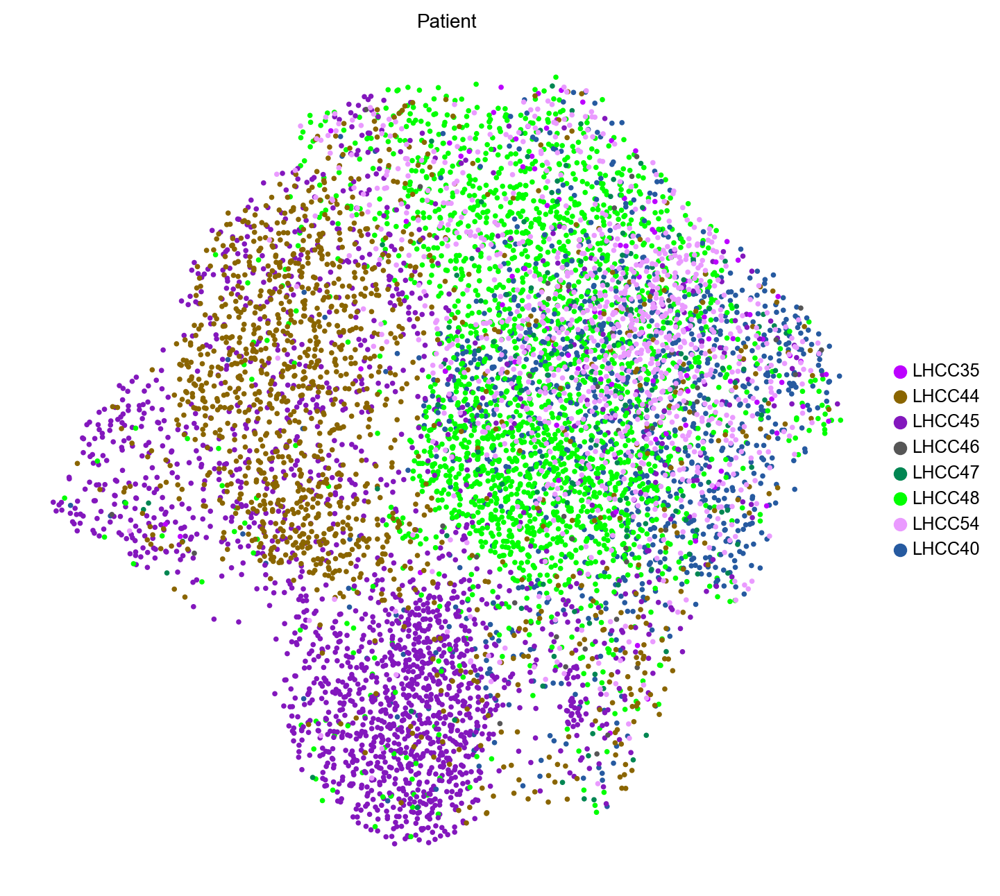

In [39]:
sc.pl.umap(adata, color="Patient", palette=patient_map, s=30, legend_loc="right margin", frameon=False, save="_MAIT-Patient.pdf")

In [40]:
dys_genes = ["CTLA4", "CXCR3", "PDCD1", "ICOS", "CD4", "FOXP3", "IL10RA", "IFNGR1", "HAVCR2", "MKI67"]
cyto_genes = ["NKG7", "NCR3", "PRF1", "KLRG1", "GNLY", "GZMA", "GZMB", "GZMH", "GZMK", "GZMM", "IFNG", "KLRB1"]

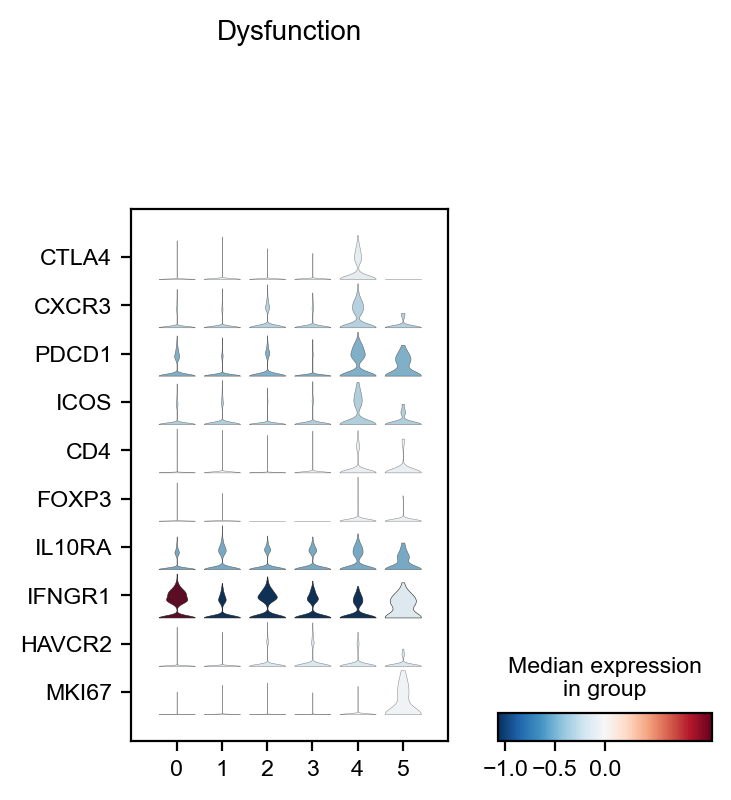

In [41]:
sc.pl.stacked_violin(adata, dys_genes, groupby=f"leiden_r0.4", dendrogram=False, use_raw=False, 
                     swap_axes=True, vcenter=0, cmap="RdBu_r", title="Dysfunction",
                     save=f"leiden_r0.4_Dysfunction_ALL.pdf")

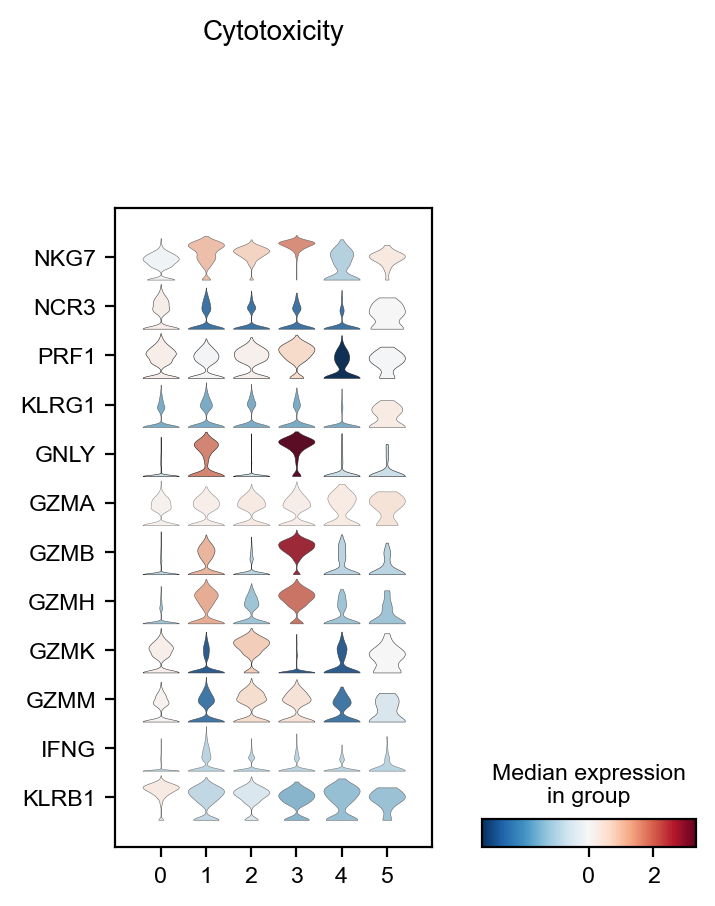

In [42]:
sc.pl.stacked_violin(adata, cyto_genes, groupby=f"leiden_r0.4", dendrogram=False, use_raw=False, 
                     swap_axes=True, vcenter=0, cmap="RdBu_r", title="Cytotoxicity",save=f"leiden_r0.4_Cytotoxicity_ALL.pdf")

## Murine model CD45

In [43]:
sc.settings.figdir = "scRNA-seq/Redone22/Manuscript/MurineModel/"

In [44]:
adata = sc.read("scRNA-seq/Redone22/Manuscript/MurineModel/Data/murineModel_processed_noPDL1_rec.h5ad")

In [45]:
murine_gene_lst = ["Cd3e", "Cd3d", "Cd4", "Cd8a", "Klrk1", "Nkg7", "Cd14", "Cd68", "Lyz2", "Csf1r", "Csf3r", 
                   "Fcer1g", "Itgam", "Itgax", "Thy1", "Batf3", "Mrc1", "Cd79a", "Cd79b", "CD19", "Ftl1", "Ccl6", 
                   "Arg1", "Il7r", "Tcf7", "Tpt1", "Arg1", "Mmp9", "Ccr2", "Trav11", "Foxp3", "Id2", "Il2rb", "Ccl5", 
                   "Gzmk", "Klrk1", "Prf1", "Ccl5", "Cd209a", "Mgl2", "Clec10a", "Siglech", "Irf8", "Cox6a2", "Hmgb2", 
                   "Mki67", "Stmn1", "Chil3", "Camp", "Lcn2", "C1qb", "C1qa", "C1qc", "Cd274"]

In [46]:
murine_gene_lst = adata.var_names.intersection(murine_gene_lst)

In [47]:
cluster_names = ["B cells 1", "Mo/Mφ_Ftl1", "T cells_Tcf7", "Mo/Mφ_Lyz2", "T cells_NKT and Treg", "T cells_CD8+ CTL", 
                 "NK cells and ILC1", "cDC2", "pDCs", "Cycling cells", "Neutrophils", "Mo/Mφ_C1qb"]

In [48]:
murine_mapper = dict(zip(adata.obs["leiden_r0.3"].cat.categories, cluster_names))

In [49]:
adata.obs["leiden_r0.3"] = adata.obs["leiden_r0.3"].replace(murine_mapper)

In [50]:
adata.obs.groupby(["Sample", "leiden_r0.3"]).count()["batch"].to_frame().to_csv("scRNA-seq/Redone22/Manuscript/MurineModel/cluster_counts.csv")

In [51]:
res = pd.DataFrame(columns=adata.var_names, index=adata.obs["leiden_r0.3"].cat.categories)                                                                                                 

for clust in adata.obs["leiden_r0.3"].cat.categories: 
    res.loc[clust] = adata[adata.obs["leiden_r0.3"].isin([clust]),:].X.mean(0)
    
res = res[murine_gene_lst]

for col in res.columns:
    res[col] = res[col].astype(np.float32)
    res[col] = (res[col]-res[col].mean())/res[col].std()
res = res.T

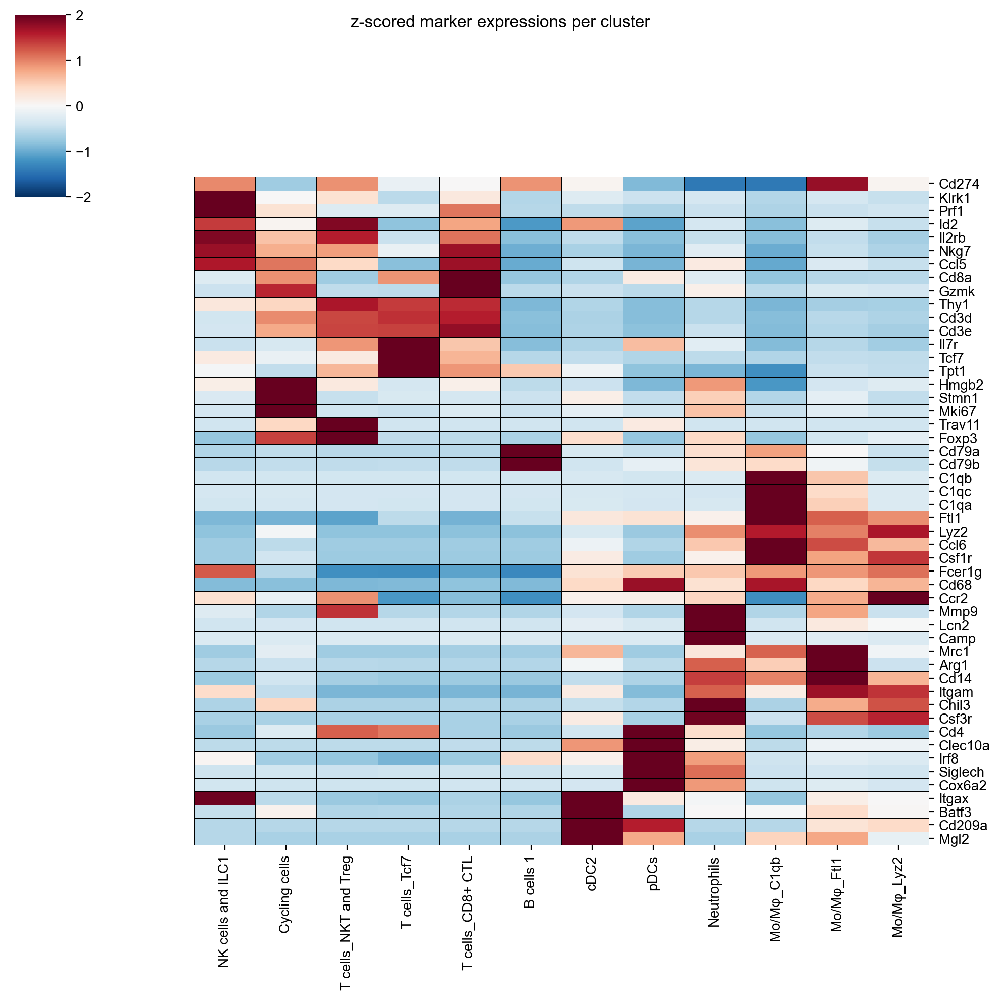

In [52]:
g = sns.clustermap(data=res, cmap=cmap, vmin=-2, vmax=2, center=0,metric="correlation", yticklabels=1, linewidths=0.2, linecolor="black",tree_kws={"linewidths": 0.})
plt.suptitle("z-scored marker expressions per cluster")
plt.savefig("scRNA-seq/Redone22/Manuscript/MurineModel/Murine_Marker_Expression_Heatmap.pdf", dpi=400, transparent=True)
plt.show()

## Myeloid subclusters

In [53]:
sc.settings.figdir = "scRNA-seq/Redone22/Manuscript/Myeloid/"

In [54]:
adata = sc.read("scRNA-seq/Redone22/Manuscript/Myeloid/Data/processed_20022023.h5ad")

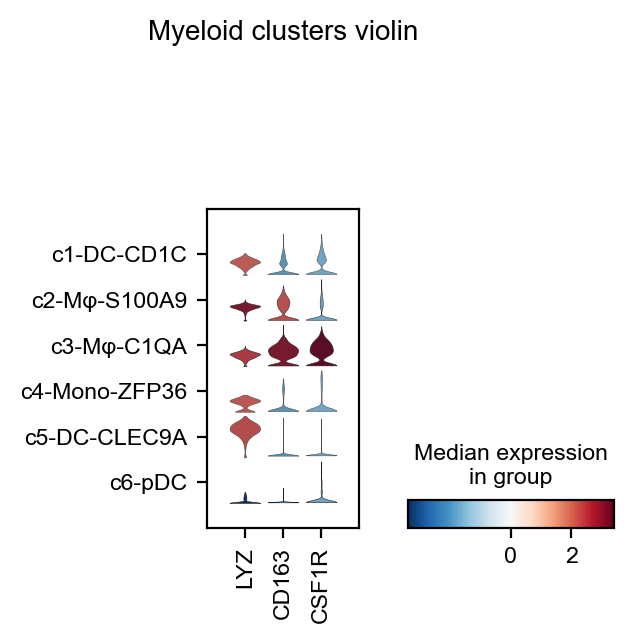

In [55]:
resolution = 0.4
sc.pl.stacked_violin(adata, ["LYZ", "CD163", "CSF1R"], groupby=f"leiden_r{resolution}", dendrogram=False, use_raw=False, 
                     swap_axes=False, vcenter=0, cmap="RdBu_r", save="_Myeloid.pdf", title="Myeloid clusters violin")

In [56]:
myeloid_genes = ["LYZ", "CD14", "ITGAX", "ITGAM", "CD68", "CSF1R", "CD163", "HLA-DQA1", "FCER1A", "CD1C", "CLEC10A", "S100A9", "TSPO", "FCN1", "TYROBP", "C1QA", 
                 "MRC1", "MARCO", "VSIG4", "ZFP36", "IL32", "SELENOP", "CCL5", "CLEC9A", "IDO1", "CD74", "C1orf54", "GZMB", "LILRA4", "IL3RA", "CXCR3"]

In [57]:
res = pd.DataFrame(columns=adata.var_names, index=adata.obs["leiden_r0.4"].cat.categories)                                                                                                 

for clust in adata.obs["leiden_r0.4"].cat.categories: 
    res.loc[clust] = adata[adata.obs["leiden_r0.4"].isin([clust]),:].X.mean(0)

In [58]:
res = res[myeloid_genes]

In [59]:
for col in res.columns:
    res[col] = res[col].astype(np.float32)
    res[col] = (res[col]-res[col].mean())/res[col].std()

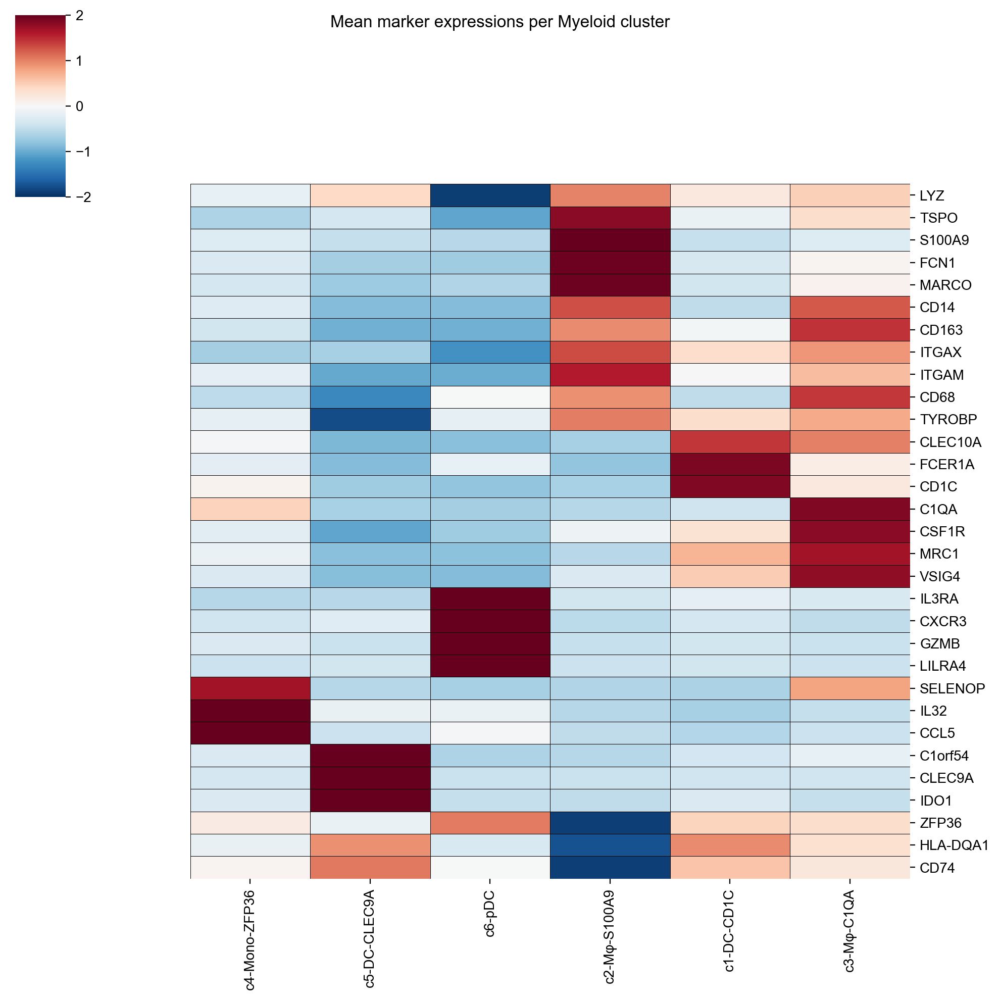

In [60]:
sns.clustermap(data=res.T, cmap="RdBu_r", center=0, vmin=-2, vmax=2, yticklabels=1, linewidths=0.2, metric="correlation",
                   linecolor="black",tree_kws={"linewidths": 0.})
plt.suptitle("Mean marker expressions per Myeloid cluster")
plt.savefig("scRNA-seq/Redone22/Manuscript/Myeloid/Myeloid_Heatmap.pdf", dpi=400, transparent=True)
plt.show()

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


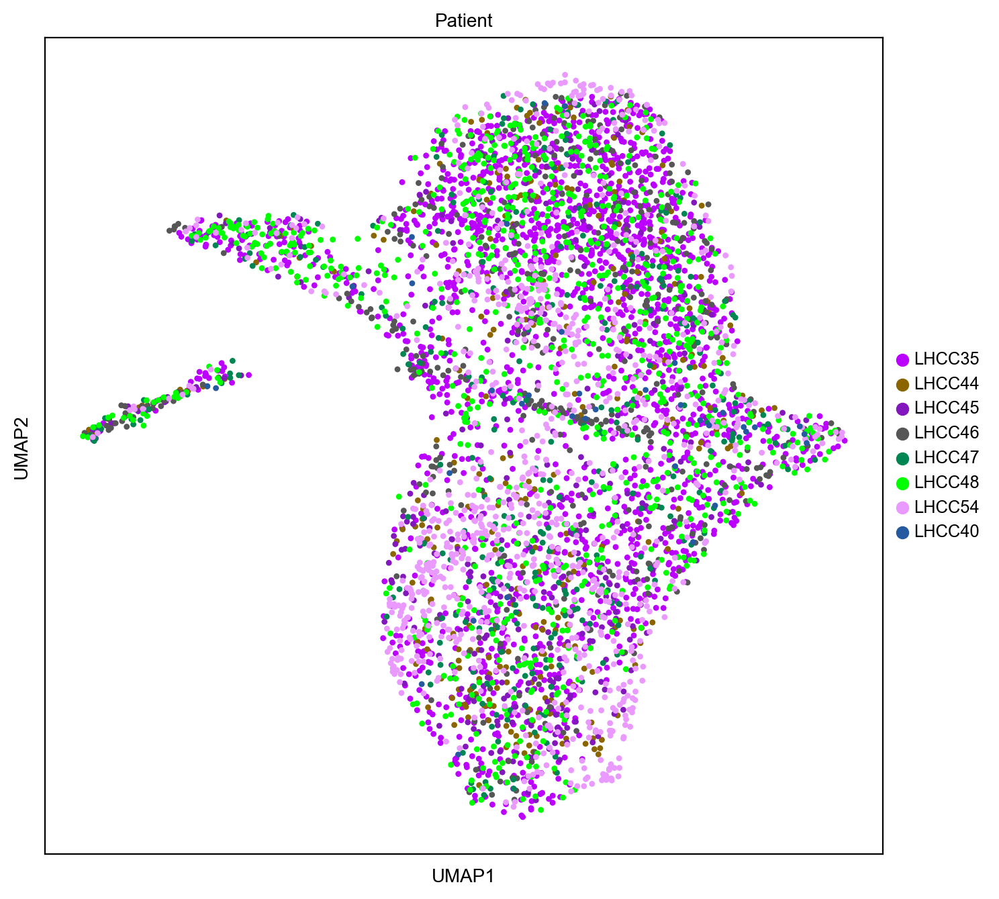

In [61]:
sc.pl.umap(adata, color="Patient", palette=patient_map,s=40, save="_Patient.pdf")

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


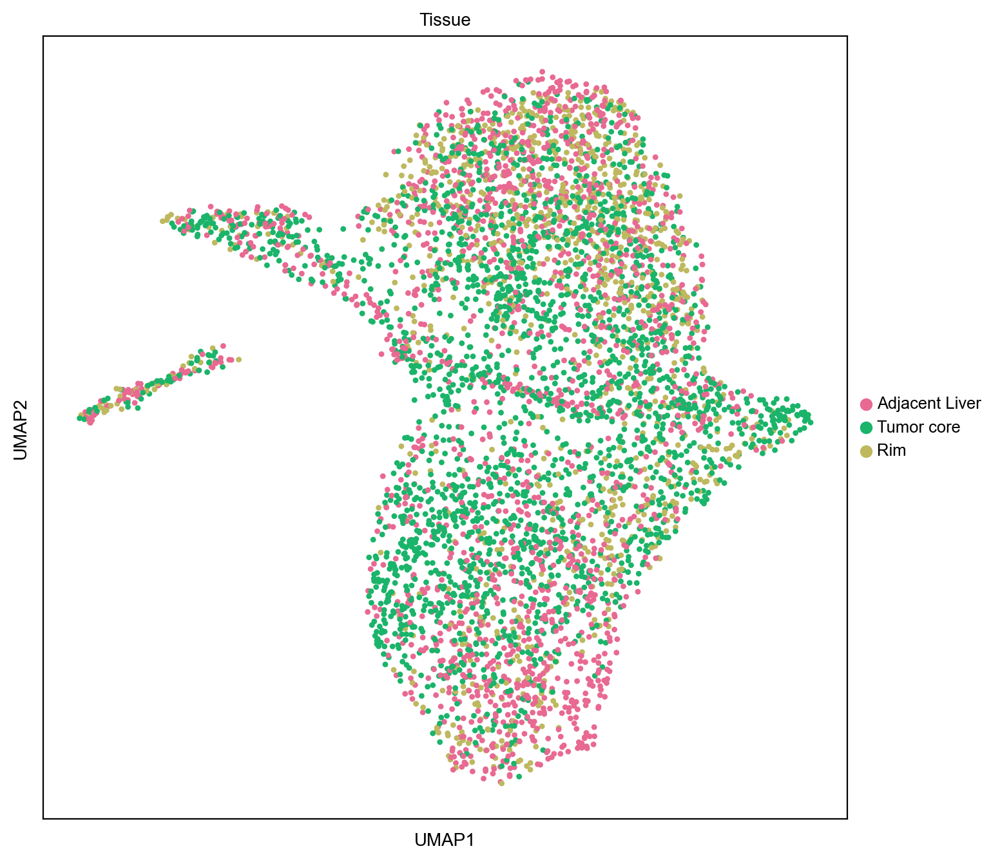

In [62]:
sc.pl.umap(adata, color="Tissue", palette=tissue_map, s=40, save="_Tissue.pdf")

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


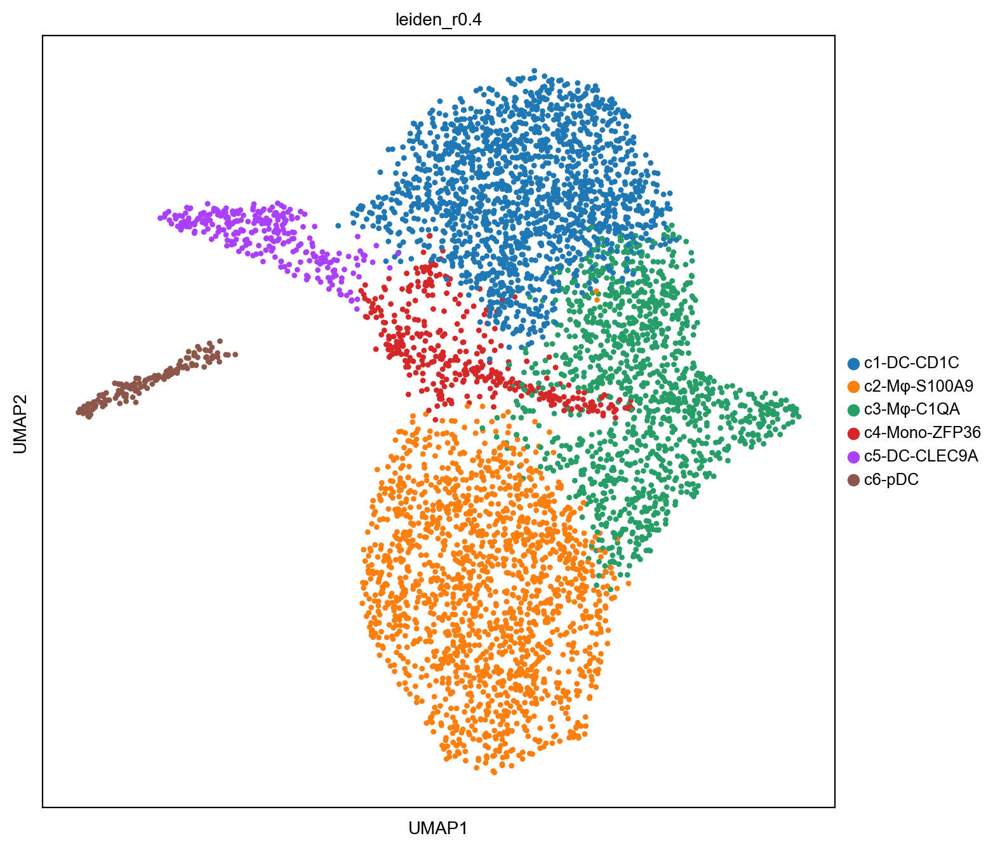

In [63]:
sc.pl.umap(adata, color="leiden_r0.4", s=40, save="_leiden_r0.4.pdf")